<a href="https://colab.research.google.com/github/ahmtox/swept-plane-scanner/blob/main/scanner_notebookt_es143.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Setup

In [1]:
# Mount your google drive. This will launch a pop-up window for authentication.

from google.colab import drive
drive.mount('/content/drive')

ModuleNotFoundError: No module named 'google'

In [ ]:
# YOU SHOULD HAVE ALREADY COPIED THE ASSIGNMENT FILES TO THIS
# FOLDER ON YOUR GOOGLE DRIVE

#cd your_path_here
%cd "/content/drive/My Drive/es-143-assignments/PROJECT/"

In [4]:
# Install pupil_apriltags package. This a wrapper for the Apriltags3 library developed by AprilRobotics.
# Documentation at https://github.com/pupil-labs/apriltags

%pip install pupil-apriltags

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 14.4 MB/s eta 0:00:00a 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pupil-apriltags: filename=pupil_apriltags-1.0.4.post10-cp39-cp39-macosx_14_0_arm64.whl size=5185143 sha256=64642de768d0cbca4dc834c986a385c414907cd43855f1a3f9ecc900bba47000
  Stored in directory: /Users/ahmtox/Library/Caches/pip/wheels/f0/8f/a3/cdc5c081eedc56610e23beda20e46042a3c60fde7361aa5532
Successfully built pupil-apriltags

[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [1]:
# Import required libraries here
import cv2                               # OpenCV
import numpy as np                       # numpy
import os
from pupil_apriltags import Detector
import requests
import pickle
import glob   # filename and path management for file I/O

import plotly.express as px
import plotly.graph_objects as go

# Use this line to make matplotlib plot inline (only need to call it once when importing matplotlib)
%matplotlib inline

import matplotlib.pyplot as plt
# Modify this line to adjust the displayed plot size. You can also call
# it with different parameters or use plt.figure(figsize=[H, W]) before specific plots.
plt.rcParams['figure.figsize'] = [10, 10]

In [2]:
# Fetch lists of target-IDs and 2D target locations (in inches) corresponding to the two
#   printed April boards.
response = requests.get("https://github.com/Harvard-CS283/pset-data/raw/f1a90573ae88cd530a3df3cd0cea71aa2363b1b3/april/AprilBoards.pickle")
data = pickle.loads(response.content)

at_coarseboard = data['at_coarseboard']
at_fineboard = data['at_fineboard']

In [4]:
#@title Helper function: `detect_aprilboard()`
# set up april tag detector (I use default parameters; seems to be OK)
at_detector = Detector(families='tag36h11',
                       nthreads=1,
                       quad_decimate=1.0,
                       quad_sigma=0.0,
                       refine_edges=1,
                       decode_sharpening=0.25,
                       debug=0)

def detect_aprilboard(img, board, apriltag_detector):
    # Usage:  imgpoints, objpoints, tag_ids = detect_aprilboard(img,board,AT_detector)
    #
    # Input:
    #   image -- grayscale image
    #   board -- at_coarseboard or at_fineboard (list of dictionaries)
    #   AT_detector -- AprilTag Detector parameters
    #
    # Returns:
    #   imgpoints -- Nx2 numpy array of (x,y) image coords
    #   objpoints -- Nx3 numpy array of (X,Y,Z=0) board coordinates (in inches)
    #   tag_ids -- Nx1 list of tag IDs

    imgpoints=[]
    objpoints=[]
    tagIDs=[]

    # detect april tags
    imgtags = apriltag_detector.detect(img,
                                    estimate_tag_pose=False,
                                    camera_params=None,
                                    tag_size=None)

    if len(imgtags):
        # collect image coordinates of tag centers
        # imgpoints = np.vstack([ sub.center for sub in tags ])

        # list of all tag_id's that are in board
        brdtagIDs = [ sub['tag_id'] for sub in board ]

        # list of all detected tag_id's that are in image
        imgtagIDs = [ sub.tag_id for sub in imgtags ]

        # list of all tag_id's that are in both
        tagIDs = list(set(brdtagIDs).intersection(imgtagIDs))

        if len(tagIDs):
            # all board list-elements that contain one of the common tag_ids
            objs=list(filter(lambda tagnum: tagnum['tag_id'] in tagIDs, board))

            # their centers
            objpoints = np.vstack([ sub['center'] for sub in objs ])

            # all image list-elements that contain one of the detected tag_ids
            imgs=list(filter(lambda tagnum: tagnum.tag_id in tagIDs, imgtags))

            # their centers
            imgpoints = np.vstack([ sub.center for sub in imgs ])

    return imgpoints, objpoints, tagIDs

def in2hom(X):
    return np.concatenate([X, np.ones((X.shape[0], 1), dtype=np.float32)], axis=1)

# Convert from Nxm homogeneous to Nx(m-1) inhomogeneous coordinates
def hom2in(X):
    return X[:, :-1] / X[:, -1:]

def intersect_ray_plane(plane, impts, calMatrix, distCoeffs):
    """
    3D intersection points from back-projected camera rays and a 3D plane

    Args:
      plane:      (a,b,c,d) plane parameters in camera coordinate system
      impts:      Nx2 array of pixel coordinates (xi,yi) to be back-projected
      calMatrix:  K-matrix as returned by cv2.calibrateCamera()
      distCoeffs: optical distortion coefficients as returned by cv2.calibrateCamera()

    Returns:
      intersections:  Nx3 array of 3D intersection-point coordinates (Xi,Yi,Zi)
    """

    impts_norm = cv2.undistortPoints(impts, calMatrix, distCoeffs).reshape((impts.shape[0], 2))
    impts_hom = in2hom(impts_norm)

    lambdas = -plane[-1]/np.array(
        plane[0]*impts_hom[:,0] + plane[1]*impts_hom[:,1] + plane[2]*impts_hom[:,2]
    )

    lambdas = lambdas[:, np.newaxis]
    intersections = lambdas*impts_hom

    return intersections

In [5]:
# @title
def add_plotly_camera(h,w,camera,raysize,figobj):
# Add tetrahedral camera to pyplot figure
# h,w:      height and width of image in pixels
# camera:   3x4 camera matrix
# raysize:  length of tetrahedral edges (in world units)
# fig:      pyplot figure object
#
# Returns: 1
#
# Uses anatomy of camera matrices from Hartley and Zisserman Chapter 6

    # normalize camera such that bottom-left three-vector
    #   corresponds to unit-length principal ray in front of camera (HZ Section 6.2.3)
    camera=camera*np.sign(np.linalg.det(camera[:,0:3]))/np.linalg.norm(camera[2,0:3])

    # Compute camera center (null vector of P)
    _, _, v = np.linalg.svd(camera)
    C = np.transpose(v[-1,0:3]) / v[-1,3]

    # Back-project image corners to unit-length 3D ray segments:
    S = np.array([[0, 0, 1],       # homog image coords if top left pixel
                  [0, h-1, 1],     # bottom left
                  [w-1, h-1, 1],   # bottom right
                  [w, 0, 1]])      # top right

    #   HZ equation (6.14): compute one 3D point along each ray
    X = np.transpose(np.linalg.lstsq(
        camera[:,0:3],
        np.transpose(S)-np.expand_dims(camera[:,3],axis=1),
        rcond=None)[0])

    #   unit-vectors from camera center to each 3D point
    V = X - np.tile(C, (4, 1))
    V = V / np.linalg.norm(V, ord=2, axis=1, keepdims=True)

    # make sure these vectors point forwards from the camera instead of backwards
    V = V*np.expand_dims(np.sign(np.sum(V * np.tile(camera[2,0:3],(4, 1)), axis=1)),axis=1)

    #   desired ray segments that are length raysize in these directions
    V = np.tile(C, (4, 1)) + raysize * V

    # append the camera center itself to complete the four tetrahedral vertices
    V=np.vstack([C,V])

    # add camera center to figure
    figobj.add_trace(go.Scatter3d(
        x=[C[0]],
        y=[C[1]],
        z=[C[2]],
        mode='markers',
        marker=dict(
            size=3,
            color='#ff7f0e'
        )
    )
                    )


    # add tetrahedron to figure
    figobj.add_trace(go.Mesh3d(
        # vertices of tetrahedron
        x=V[:,0],
        y=V[:,1],
        z=V[:,2],

        # i, j and k give the vertices of triangles
        i=[0, 0, 0, 0],
        j=[1, 2, 3, 4],
        k=[2, 3, 4, 1],
        opacity=0.5,
        color='#ff7f0e'
    ))

    return 1

def add_plotly_plane(plane,figobj):
# Add 3D plane to pyplot figure
# plane:   (a,b,c,d) plane parameters
# fig:      pyplot figure object
#
# Returns: 1
#
# Note: this function only works for this assignment's particular set of planes

    # create regular grid of X,Y,Z values that span the volume that is relevant to
    # this assignment's planes
    #   (numpy.mgrid trick: j (complex) in step size forces inclusion of stop value)
    X, Y, Z = np.mgrid[-10:10:40j, -18:10:40j, 20:42:40j]

    # evaluate the linear functions on this volumetric grid that is zero at the plane
    implicitplane = plane[0]*X + plane[1]*Y + plane[2]*Z + plane[3]

    # display using plotly's isosurface trace
    figobj.add_trace(go.Isosurface(
          x=X.flatten(),
          y=Y.flatten(),
          z=Z.flatten(),
          value=implicitplane.flatten(),
          isomin=0,
          isomax=0,
          opacity=0.3,
          colorscale='blues',
          showscale=False, # remove colorbar
          ))

    return 1

# Calibrate Camera

In [32]:
#@title extract keyframes
!ffmpeg -i ./data/calibration.mov -vf "select='eq(pict_type,I)', extractplanes=y" -pix_fmt gray -vsync vfr -q:v 2 ./data/out_keyframes_%04d.png

ffmpeg version 6.0 Copyright (c) 2000-2023 the FFmpeg developers
  built with Apple clang version 14.0.0 (clang-1400.0.29.202)
  configuration: --prefix=/opt/homebrew/Cellar/ffmpeg/6.0_2 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags= --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libspeex --enable-libsoxr --enable-libzmq --enable-libzimg --dis

27 images:
0 ./data/out_keyframes_0002.png: 78 imgpts, 78 objpts
1 ./data/out_keyframes_0016.png: 80 imgpts, 80 objpts
2 ./data/out_keyframes_0017.png: 80 imgpts, 80 objpts
3 ./data/out_keyframes_0003.png: 80 imgpts, 80 objpts
4 ./data/out_keyframes_0015.png: 80 imgpts, 80 objpts
5 ./data/out_keyframes_0001.png: 73 imgpts, 73 objpts
6 ./data/out_keyframes_0014.png: 80 imgpts, 80 objpts
7 ./data/out_keyframes_0010.png: 80 imgpts, 80 objpts
8 ./data/out_keyframes_0004.png: 80 imgpts, 80 objpts
9 ./data/out_keyframes_0005.png: 80 imgpts, 80 objpts
10 ./data/out_keyframes_0011.png: 80 imgpts, 80 objpts
11 ./data/out_keyframes_0007.png: 80 imgpts, 80 objpts
12 ./data/out_keyframes_0013.png: 80 imgpts, 80 objpts
13 ./data/out_keyframes_0012.png: 80 imgpts, 80 objpts
14 ./data/out_keyframes_0006.png: 80 imgpts, 80 objpts
15 ./data/out_keyframes_0023.png: 80 imgpts, 80 objpts
16 ./data/out_keyframes_0022.png: 80 imgpts, 80 objpts
17 ./data/out_keyframes_0008.png: 80 imgpts, 80 objpts
18 ./data

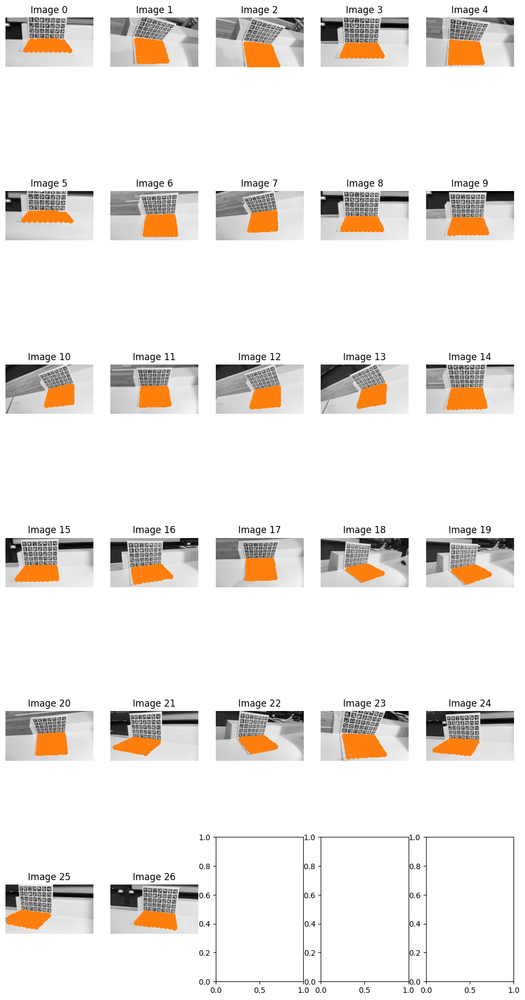

In [6]:
#@title detect fiducials

N = 70 # only use images with at least N detected objects for calibration
total_valid = 0

# Edit this line to point to the collection of input calibration image
CALIBFILES = './data/out_keyframes_*.png'

# Uncomment one of the following two lines to indicate which AprilBoard is being used (fine or coarse)
BOARD = at_fineboard
#BOARD = at_coarseboard

###### BEGIN CALIBRATION SCRIPT

# exit if no images are found or if BOARD is unrecognized
images = glob.glob(CALIBFILES)
assert images, "no calibration images matching: " + CALIBFILES
assert BOARD==at_fineboard or BOARD==at_coarseboard, "Unrecognized AprilBoard"

# else continue
print("{} images:".format(len(images)))

# initialize 3D object points and 2D image points
calObjPoints = []
calImgPoints = []

# define the number of columns for the plot, then calculate number of rows
num_plot_cols = 5
num_plot_rows = (len(images) + num_plot_cols - 1) // num_plot_cols

# create the figure and axes; flatten the axes array for convenvience
fig, axs = plt.subplots(num_plot_rows, num_plot_cols, figsize=(12, 4*num_plot_rows))
axs = axs.flatten()

# loop through the images
for count,fname in enumerate(images):

    # read image and convert to grayscale if necessary
    orig = cv2.imread(fname)
    if len(orig.shape) == 3:
        img = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
    else:
        img = orig

    # show image
    axs[count].imshow(img / 255.0, cmap="gray")
    axs[count].set_axis_off()
    axs[count].set_title("Image {}".format(count))

    # detect apriltags and report number of detections
    imgpoints, objpoints, tagIDs = detect_aprilboard(img,BOARD,at_detector)
    #print("{} {}: {} imgpts, {} objpts".format(count, fname, len(imgpoints),len(objpoints)))
    print(f"{count} {fname}: {len(imgpoints)} imgpts, {len(objpoints)} objpts")

    # append detections if some are found
    if len(imgpoints) >= N and len(objpoints) >= N:
        total_valid += 1
        # display detected tag centers
        axs[count].scatter(imgpoints[:,0], imgpoints[:,1], marker='o', color='#ff7f0e')

        # append points detected in all images, (there is only one image now)
        calObjPoints.append(objpoints.astype('float32'))
        calImgPoints.append(imgpoints.astype('float32'))

# plt.show()

In [7]:
#@title calibrate camera

# calibrate the camera
reprojerr, calMatrix, distCoeffs, calRotations, calTranslations = cv2.calibrateCamera(
    calObjPoints,
    calImgPoints,
    img.shape,    # uses image H,W to initialize the principal point to (H/2,W/2)
    None,         # no initial guess for the remaining entries of calMatrix
    None,         # initial guesses for distortion coefficients are all 0
    flags = None) # default contstraints (see documentation)

# Print output, including reprojection error, which is the root mean square (RMS)
#   re-projection error in pixels. If this value is much greater than 1, it is
#   likely to be a bad calibration.  Examine the images and detections, and the
#   options given to cv2.calibrateCamera() to figure out what went wrong.
np.set_printoptions(precision=5, suppress=True)
print('RMSE of reprojected points:', reprojerr)
print('Distortion coefficients:', distCoeffs)

np.set_printoptions(precision=2, suppress=True)
print('Intrinsic camera matrix:\n', calMatrix)
print('Total images used for calibration: ', total_valid)

RMSE of reprojected points: 1.8885231116310937
Distortion coefficients: [[-0.24266  1.41557  0.01165 -0.08868 -1.8428 ]]
Intrinsic camera matrix:
 [[1786.75    0.    571.02]
 [   0.   2160.37  914.49]
 [   0.      0.      1.  ]]
Total images used for calibration:  27


In [8]:
#@title Compute reprojection error separately in each image

# initial array for storing per-image reprojection errors
mean_errors=[]

# project 3D board points into the images, and compute the per-image reprojection error
for i in range(len(calObjPoints)):
    imgpoints2, _ = cv2.projectPoints(calObjPoints[i], calRotations[i], calTranslations[i], calMatrix, distCoeffs)
    mean_errors.append(np.mean(np.linalg.norm(calImgPoints[i] - np.squeeze(imgpoints2),axis=1)))

print("Per-image reprojection errors:")

# Print the list of per-image reprojection errors with at most 5 elements per line
print('\n'.join([', '.join([f"{error:.{5}f}" for error in mean_errors[i:i+5]]) for i in range(0, len(mean_errors), 5)]))

Per-image reprojection errors:
1.23743, 3.62392, 2.87648, 1.32942, 2.44291
1.18622, 1.43574, 1.41038, 1.31330, 1.33174
1.24147, 1.45297, 1.28236, 1.38168, 1.36556
1.14282, 1.38686, 2.12623, 0.94673, 1.03524
1.68127, 0.98894, 0.99102, 2.10790, 0.87886
1.14654, 1.37785


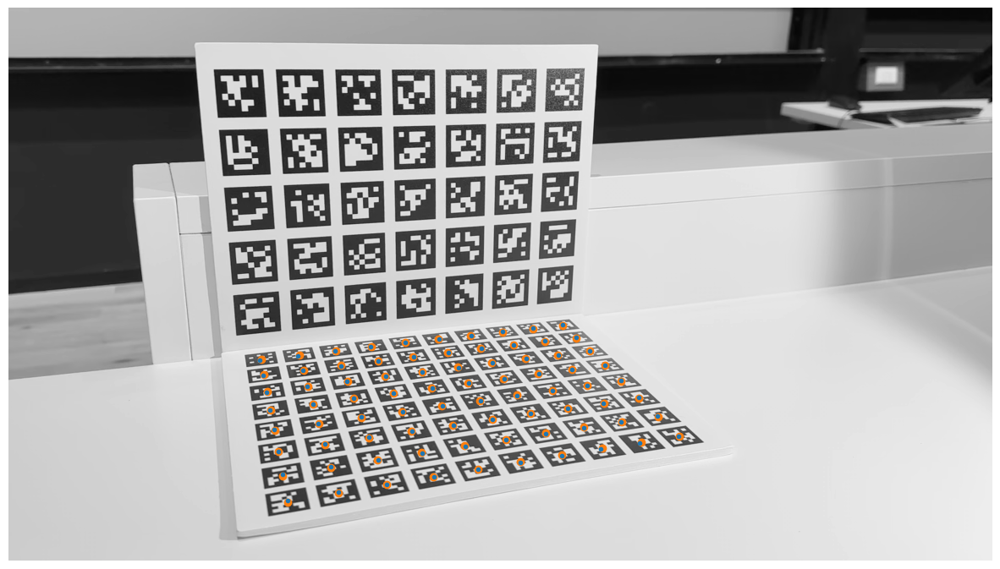

In [9]:
#@title Display the projected points in one of the images

# change this to select which calibration image to display
IMNUM=16

# read image and convert to grayscale if necessary
orig = cv2.imread(images[IMNUM])
if len(orig.shape) == 3:
    img = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
else:
    img = orig

# create figure, show image
fig,ax =plt.subplots(figsize=(15,15))
ax.imshow(img / 255.0, cmap="gray")
ax.set_axis_off()

# show detected points (in orange)
ax.scatter(calImgPoints[IMNUM][:,0], calImgPoints[IMNUM][:,1], marker='o', color='#ff7f0e')

# compute reprojections
imgpoints2, _ = cv2.projectPoints(calObjPoints[IMNUM],
                                  calRotations[IMNUM],
                                  calTranslations[IMNUM],
                                  calMatrix, distCoeffs)
imgpoints2=np.squeeze(imgpoints2) # eliminate the leading single dimension

# show reprojected points (in blue)
ax.scatter(imgpoints2[:,0], imgpoints2[:,1], marker='.', color='#1f77b4')

# Python Functions

### computeTwoPlanes()

In [13]:
np.set_printoptions(precision=8)

In [14]:
def computeTwoPlanes(calMatrix, distCoeffs, image_path):
    # read image and convert to grayscale if necessary
    orig = cv2.imread(image_path)
    if len(orig.shape) == 3:
        img = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
    else:
        img = orig

    # detect apriltags and report number of detections. Do this for both boards (fine and coarse).
    imgpoints_fine, objpoints_fine, tagIDs_fine = detect_aprilboard(img,at_fineboard,at_detector)
    imgpoints_coarse, objpoints_coarse, tagIDs_coarse = detect_aprilboard(img,at_coarseboard,at_detector)

    # compute normalized image coordinates (equivalent to K^{-1}*x)
    imgpts_fine_norm = cv2.undistortPoints(imgpoints_fine, calMatrix, distCoeffs) # OUTPUTS Nx2, a 2-vector for the back-projected ray of each of N points
    imgpts_coarse_norm = cv2.undistortPoints(imgpoints_coarse, calMatrix, distCoeffs)

    # homographies from each board to normalized image pts
    H_fine,_ = cv2.findHomography(objpoints_fine[:,:2],imgpts_fine_norm) # RETURNS H = [r1, r2, t]
    H_coarse,_ = cv2.findHomography(objpoints_coarse[:,:2],imgpts_coarse_norm)

    # extract rotation and translation from homography: fineboard
    H_fine = 2*H_fine/(np.linalg.norm(H_fine[:,0]) + np.linalg.norm(H_fine[:,1]))
    R_fine = np.hstack((H_fine[:,:2],np.atleast_2d(np.cross(H_fine[:,0],H_fine[:,1])).T))
    rvec_fine,_ = cv2.Rodrigues(R_fine)
    R_fine,_ = cv2.Rodrigues(rvec_fine)
    tvec_fine=H_fine[:,2]

    # extract rotation and translation from homography: coarseboard
    H_coarse = 2*H_coarse/(np.linalg.norm(H_coarse[:,0]) + np.linalg.norm(H_coarse[:,1])) # SCALE H such that norms of r1 and r2 are close to 1
    R_coarse = np.hstack((H_coarse[:,:2],np.atleast_2d(np.cross(H_coarse[:,0],H_coarse[:,1])).T)) # ESTIMATES r3 (cross r1 r2). Now we have estimate of R, orthogonal and unit length columns
    rvec_coarse,_ = cv2.Rodrigues(R_coarse) # Find real R that is closest to estimate R, outputs axis-angle representation
    R_coarse,_ = cv2.Rodrigues(rvec_coarse) # Outputs 3x3 R
    tvec_coarse=H_coarse[:,2]

    pi_h = np.hstack([R_fine[:,2], np.dot(-R_fine[:,2].T, tvec_fine)])
    pi_v = np.hstack([R_coarse[:,2], np.dot(-R_coarse[:,2].T, tvec_coarse)])
    print(pi_h)
    print(pi_v)
    return pi_h, pi_v

In [15]:
print(calMatrix)
print(distCoeffs)
plane_h, plane_v = computeTwoPlanes(calMatrix, distCoeffs, 'empty_boards.jpg')
plane_h, plane_v

[[1786.75467182    0.          571.02004006]
 [   0.         2160.37047378  914.4876054 ]
 [   0.            0.            1.        ]]
[[-0.24266223  1.41557424  0.01164999 -0.0886805  -1.84280295]]
[-0.1184542  -0.90046668 -0.4184834   7.54567613]
[-0.17785252  0.43667061 -0.88186578 26.05475314]


(array([-0.1184542 , -0.90046668, -0.4184834 ,  7.54567613]),
 array([-0.17785252,  0.43667061, -0.88186578, 26.05475314]))

### processVideo()

In [29]:
from tqdm.notebook import tqdm


def processVideo(video_path, background_mask, foreground_mask, sweep_direction='l_r'):

    print('Computing Min-Max Values')
    min_values, max_values, height, width = compute_min_max_values(video_path)

    print('Computing Shadow')
    shadow_threshold = compute_shadow(min_values, max_values)

    print('Finding Shadow Edges in Background Mask')
    bg_edge_points = compute_shadow_edge_background(
        video_path, background_mask, shadow_threshold, height, width)

    print(bg_edge_points.shape)

    print('Finding Shadow Edges in Foreground Mask')
    fg_edge_times = compute_shadow_edge_foreground(
        video_path, foreground_mask, shadow_threshold, height, width)

    print('Processing Shadow Points')
    final_output = np.full((height, width), np.nan)

    for frame_index, crossings in enumerate(bg_edge_points):
        for crossing in crossings:
            x, y = int(round(crossing[0])), int(crossing[1])
            final_output[y, x] = frame_index

    for row in range(height):
      for col in range(width):
        val = fg_edge_times[y, x]
        if val is not np.nan:
          final_output[y, x] = val

    print('Done!')

    return final_output


def compute_min_max_values(video_path):

  cap = cv2.VideoCapture(video_path)

  width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
  height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

  min_values = np.full((height, width), np.inf)
  max_values = np.full((height, width), -np.inf)

  while cap.isOpened():

    ret, frame = cap.read()

    if not ret:
      break

    if len(frame.shape) > 2:
      frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    else:
      frame_gray = frame

    min_values = np.minimum(min_values, frame_gray)
    max_values = np.maximum(max_values, frame_gray)

  cap.release()

  return min_values, max_values, height, width



def compute_shadow_edge_background(video_path, background_mask, shadow, height, width):
    cap = cv2.VideoCapture(video_path)

    if (int(background_mask.shape[0]) != int(height) or int(background_mask.shape[1]) != int(width)):
        raise ValueError("Mask and Video frames have different shapes")

    right_edge_shadow_points = []

    while cap.isOpened():
        ret, frame = cap.read()
        frame_right_edge_shadow_points = []

        if not ret:
            break

        if len(frame.shape) > 2:
            frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        else:
            frame_gray = frame

        relative_frame = frame_gray - shadow
        relative_frame_masked = relative_frame * background_mask

        for i, row in enumerate(relative_frame_masked):
            if np.any(row != 0.0):
                signs = np.sign(row)
                diff = np.diff(signs)
                crossing_indices = np.where((diff != 0) & (signs[:-1] > 0) & (signs[1:] < 0))[0]

                if crossing_indices.size == 0:
                  frame_right_edge_shadow_points.append((0, i))
                else:
                  last_crossing_index = crossing_indices[-1]
                  zero_crossing_x = compute_zero_crossing(
                      ((last_crossing_index, row[last_crossing_index]),
                        (last_crossing_index + 1, row[last_crossing_index + 1]))
                  )
                  frame_right_edge_shadow_points.append((zero_crossing_x, i))


        right_edge_shadow_points.append(np.array(frame_right_edge_shadow_points))

    cap.release()
    return np.array(right_edge_shadow_points)


def compute_shadow_edge_foreground(video_path, foreground_mask, shadow, height, width, chunk_size=100):

    rows, cols = foreground_mask.shape
    if int(rows) != int(height) or int(cols) != int(width):
        raise ValueError("Mask and video frames have different shapes")

    earlier_edge_times = np.full((height, width), np.nan)
    cap = cv2.VideoCapture(video_path)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    chunks = [(start, min(start + chunk_size, total_frames)) for start in range(0, total_frames, chunk_size)]

    for row in tqdm(range(rows)):
        for col in range(cols):
            if foreground_mask[row, col] != 0.0:
                pixel_vals = []
                frame_indices = []
                for start, end in chunks:
                    cap.set(cv2.CAP_PROP_POS_FRAMES, start)
                    for _ in range(start, end):
                        ret, frame = cap.read()
                        if not ret:
                            break
                        if len(frame.shape) > 2:
                            frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
                        else:
                            frame_gray = frame
                        relative_frame = frame_gray.astype(int) - shadow.astype(int)
                        pixel_val = relative_frame[row, col]
                        pixel_vals.append(pixel_val)
                        frame_indices.append(cap.get(cv2.CAP_PROP_POS_FRAMES) - 1)

                earlier_edge_zero = compute_zero_crossing_time(pixel_vals, frame_indices)
                if earlier_edge_zero is not np.nan:
                    earlier_edge_times[row, col] = earlier_edge_zero

    cap.release()
    return earlier_edge_times


def compute_zero_crossing_time(pixel_vals, frame_indices):

    for i in range(1, len(pixel_vals)):
        if pixel_vals[i-1] > 0 and pixel_vals[i] < 0:
            y1, y2 = pixel_vals[i-1], pixel_vals[i]
            x1, x2 = frame_indices[i-1], frame_indices[i]
            m = (y2 - y1) / (x2 - x1)
            if m != 0:
                x_zero = x1 - (y1 / m)
                return x_zero
    return np.nan


def compute_shadow(min_values, max_values):
  shadow = (max_values - min_values) / 2
  return shadow

def compute_zero_crossing(points):

  p1, p2 = points
  x1, y1 = p1
  x2, y2 = p2
  m = (y2 - y1) / (x2 - x1)
  x_zero = x1 - (y1 / m)

  return x_zero

def process_shadow_points(edge_points, edge_times_array):
    for frame_number, frame_info in enumerate(edge_points):
        for x, y in frame_info:
            edge_times_array[y, x] = frame_number

In [30]:
from PIL import Image

video_path = "data/shadow_sweep.mov"
background_mask = cv2.imread('background_mask_2.png', cv2.IMREAD_GRAYSCALE)
foreground_mask = cv2.imread('foreground_mask.png', cv2.IMREAD_GRAYSCALE)

front_edge_times = processVideo(video_path, background_mask, foreground_mask, sweep_direction='l_r')

print("Front edge times shape:", front_edge_times.shape)
print("max", np.max(front_edge_times))
print("min", np.min(front_edge_times))
print("Front edge times:\n", front_edge_times)

img = Image.fromarray(front_edge_times, 'L')
img.show()



libpng warning: iCCP: known incorrect sRGB profile


Computing Min-Max Values
Computing Shadow
Finding Shadow Edges in Background Mask
(378, 710, 2)
Finding Shadow Edges in Foreground Mask


ImportError: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html

### computeShadowPlanes()

In [18]:
def computeShadowPlanes(foreground_mask, background_mask, front_edge_times, plane_h, plane_v, calMatrix, distCoeffs):
    shadow_planes = []

    foreground_mask = np.where(foreground_mask > 0, 1, 0)
    background_mask = np.where(background_mask > 0, 1, 0)

    bg_indices = np.where(background_mask == 1)

    for frame_index, time in enumerate(front_edge_times):
        bg_pixels = np.array([bg_indices[1][frame_index], bg_indices[0][frame_index]]).T 

        points_2d = bg_pixels.reshape(-1, 1, 2).astype(np.float32)  
        points_3d = cv2.undistortPoints(points_2d, calMatrix, distCoeffs)

        plane_v_3d = plane_v[:3]
        plane_h_3d = plane_h[:3]

        point_3d = points_3d[0, 0] 

        line_v = np.cross(plane_v_3d, point_3d)
        line_h = np.cross(plane_h_3d, point_3d)

        shadow_plane = np.cross(line_v, line_h)
        shadow_plane /= np.linalg.norm(shadow_plane[:3])
        
        shadow_plane = np.append(shadow_plane, 0)

        shadow_planes.append(shadow_plane)

    return shadow_planes

In [19]:
# Display properties of the video
print(front_edge_times.shape)
print("plane_h: \n", plane_h)
print("plane_h: \n", plane_v)

# Load the background and foreground mask images
background_mask = cv2.imread('background_mask.png', cv2.IMREAD_GRAYSCALE)
foreground_mask = cv2.imread('foreground_mask.png', cv2.IMREAD_GRAYSCALE)

# Test the computeShadowPlanes() function
shadow_planes = computeShadowPlanes(foreground_mask, background_mask, front_edge_times, plane_h, plane_v, calMatrix, distCoeffs)

# Display the resulting shadow planes (probably wrong cuz foreground mask and background mask and front_edge_times)
print("Shadow Planes:")
print(shadow_planes)
print(len(shadow_planes))

(1080, 1920)
plane_h: 
 [-0.1184542  -0.90046668 -0.4184834   7.54567613]
plane_h: 
 [-0.17785252  0.43667061 -0.88186578 26.05475314]
Shadow Planes:
[array([-0.63027844,  0.77636917, -0.        ,  0.        ]), array([-0.63097865,  0.77580019,  0.        ,  0.        ]), array([-0.63167734,  0.77523141, -0.        ,  0.        ]), array([-0.63237461,  0.77466274,  0.        ,  0.        ]), array([-0.63307039,  0.77409423, -0.        ,  0.        ]), array([-0.63376476,  0.77352584,  0.        ,  0.        ]), array([-0.63445766,  0.77295762,  0.        ,  0.        ]), array([-0.63514913,  0.77238952,  0.        ,  0.        ]), array([-0.63583914,  0.7718216 , -0.        ,  0.        ]), array([-0.63652774,  0.77125381, -0.        ,  0.        ]), array([-0.63721484,  0.77068622,  0.        ,  0.        ]), array([-0.63790054,  0.77011876,  0.        ,  0.        ]), array([-0.6385848 ,  0.76955146,  0.        ,  0.        ]), array([-0.63926766,  0.7689843 ,  0.        ,  0.       

### computeObjectPoints()

In [20]:
def computeObjectPoints(shadow_planes, calMatrix, distCoeffs, object_mask):
    object_points = []

    for frame, plane in enumerate(shadow_planes, start=1):
        object_pixels = np.argwhere(object_mask[frame - 1] > 0)
        print("Object pixels shape:", object_pixels.shape)

        if len(object_pixels) == 0:
            continue

        intersections = intersect_ray_plane(plane, object_pixels, calMatrix, distCoeffs)
        object_points.extend(intersections)

    return np.array(object_points)


In [63]:
# object_points = computeObjectPoints(shadow_planes, calMatrix, distCoeffs, foreground_mask)


### visualizeObjectPoints()

In [24]:
def visualizeObjectPoints(img, calMatrix, pi_v=[0,0,0,0], pi_h=[0,0,0,0], points=[0,0,0]):

  fig = go.Figure()

  # draw the camera P = K[I | 0] (since we are using a camera-centered coordinate system)
  h,w = img.shape
  P = np.hstack((calMatrix,np.zeros((3,1))))
  add_plotly_camera(h,w,P,1,fig)

  # draw the two planes
  add_plotly_plane(pi_v,fig)
  add_plotly_plane(pi_h,fig)

#   # draw the computed intersections
#   fig.add_trace(go.Scatter3d(x=points[:,0],
#                             y=points[:,1],
#                             z=points[:,2],
#                             mode='markers',
#                             marker=dict(
#                                 size=2,
#                                 color='#1f77b4'
#                             )
#                             ))


  # adjust aspect ratio and initial viewing direction
  fig.update_layout(scene_aspectmode='manual',
                    scene_aspectratio=dict(x=1, y=2, z=3),
                    showlegend=False,
                    scene_camera=dict(
                        up=dict(x=0, y=-1, z=0),
                        center=dict(x=0, y=0, z=0),
                        eye=dict(x=-1, y=-1, z=-5)
                    )
                    )

  fig.show()

In [25]:
print("pi_h", plane_h)
print("pi_v", plane_v)

orig = cv2.imread('empty_boards.jpg')
if len(orig.shape) == 3:
    img = cv2.cvtColor(orig, cv2.COLOR_RGB2GRAY)
else:
    img = orig

visualizeObjectPoints(img, calMatrix, plane_v, plane_h)

pi_h [-0.1184542  -0.90046668 -0.4184834   7.54567613]
pi_v [-0.17785252  0.43667061 -0.88186578 26.05475314]
